In [1]:
import os, sys
import cv2
import numpy as np
import uuid
import tensorflow as tf
from skimage.io import imread, imsave, imshow
from PIL import Image, ImageTk
import matplotlib.pyplot as plt
from imutils import paths
import itertools
import json
from pprint import pprint

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from core.imageprep import dir_checker, random_crop, crop_generator, random_crop_batch
from core.models import UNet

from tensorflow.keras.models import load_model

from core.imageprep import create_crop_idx, crop_to_patch, construct_from_patch
from core.train_predict import stack_predict
from tqdm.notebook import trange


get_ipython().run_line_magic('load_ext', 'autoreload')
get_ipython().run_line_magic('autoreload', '2')

 ## Load Training Dataset

In [2]:
# load image
print("Load Images...")
# on mac
# path = "/Volumes/LaCie_DataStorage/PerlmutterData/"

# on Window PC 
path = os.path.join('D:', 'PerlmutterData')

# experiment
exp_name = 'dl_seg_project_raw'
# trianing timestamp
imginput_timestamp = '2019_12_06_17_06'
model_training_timestamp = '2019_12_06_17_14'
print('Training timestamp: {}'.format(model_training_timestamp))

# input img path
imginput = os.path.join(exp_name, 'data_crop', imginput_timestamp)
imgpath = os.path.join(path, imginput)
print('Input Images Path: {}'.format(imgpath))

# model path
modelfd = 'model'
modelfn = 'model_' + model_training_timestamp + '.h5'
path_model = os.path.join(path, modelfd, modelfn)
print('Model Path: {}'.format(path_model))

# raw path
rawfd = 'raw'
path_raw = os.path.join(path, rawfd)
print('Raw Path: {}'.format(path_raw))

# prediction path
pred_path = os.path.join(path, exp_name)
dir_checker('pred_img', pred_path)

Load Images...
Training timestamp: 2019_12_06_17_14
Input Images Path: D:PerlmutterData\dl_seg_project_raw\data_crop\2019_12_06_17_06
Model Path: D:PerlmutterData\model\model_2019_12_06_17_14.h5
Raw Path: D:PerlmutterData\raw
pred_img exists in D:PerlmutterData\dl_seg_project_raw


## Parameter

In [3]:
# load parameter
parsfd = 'pars'
parsfn = 'pars_' + model_training_timestamp + '.json'
path_pars = os.path.join(path, parsfd, parsfn)

with open(path_pars) as json_file:
    pars = json.load(json_file)

In [4]:
pprint(pars)

{'IMG_HEIGHT': 256,
 'IMG_WIDTH': 256,
 'batch_size': 16,
 'classes': ['cell_membrane', 'nucleus', 'autophagosome'],
 'data_gen_img_args': {'height_shift_range': 0.1,
                       'horizontal_flip': True,
                       'rescale': 0.00392156862745098,
                       'rotation_range': 90.0,
                       'shear_range': 0.07,
                       'validation_split': 0.1,
                       'vertical_flip': True,
                       'width_shift_range': 0.1,
                       'zoom_range': 0.2},
 'data_gen_label_args': {'height_shift_range': 0.1,
                         'horizontal_flip': True,
                         'rescale': 0.00392156862745098,
                         'rotation_range': 90.0,
                         'shear_range': 0.07,
                         'validation_split': 0.1,
                         'vertical_flip': True,
                         'width_shift_range': 0.1,
                         'zoom_range': 0.2},
 'epo

In [5]:
label = pars['inputclass']
IMG_HEIGHT = pars['IMG_HEIGHT']
IMG_WIDTH = pars['IMG_WIDTH']

## Predict from Testing Dataset

In [6]:
# get dataset
rawfdlist = os.listdir(path_raw)
print(rawfdlist)

['data_d00_batch01_loc01', 'data_d07_batch01_loc01', 'data_d14_batch01_loc01', 'data_d17_batch01_loc01', 'data_d21_batch01_loc01']


In [7]:
rawimglist = {}
for folder in rawfdlist:
    print(folder)
    rawimglist[folder] = list(paths.list_images(os.path.join(path_raw, folder, 'Aligned')))

data_d00_batch01_loc01
data_d07_batch01_loc01
data_d14_batch01_loc01
data_d17_batch01_loc01
data_d21_batch01_loc01


In [8]:
pprint(rawimglist)

{'data_d00_batch01_loc01': ['D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0001.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0002.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0003.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0004.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0005.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0006.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0007.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0008.tif',
                            'D:PerlmutterData\\raw\\data_d00_bat

 'data_d07_batch01_loc01': ['D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0001.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0002.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0003.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0004.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0005.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0006.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0007.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_0008.tif',
                            'D:PerlmutterData\\raw\\data_d07_batch01_loc01\\Aligned\\TH-4891-7dayDOX_000

                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0985.tif',
                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0986.tif',
                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0987.tif',
                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0988.tif',
                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0989.tif',
                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0990.tif',
                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0991.tif',
                            'D:PerlmutterData\\raw\\data_d14_batch01_loc01\\Aligned\\TH-4891-14dayDOX-C-H16_0992.tif',
                            'D:PerlmutterData\\r

                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0789.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0790.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0791.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0792.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0793.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0794.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0795.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17dayDOX_0796.tif',
                            'D:PerlmutterData\\raw\\data_d17_batch01_loc01\\Aligned\\TH-4891-17d

                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0790.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0791.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0792.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0793.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0794.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0795.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0796.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21dayDOX_0797.tif',
                            'D:PerlmutterData\\raw\\data_d21_batch01_loc01\\Aligned\\TH-4891-21d

## Define Prediction Set 

In [9]:
samplesize = 10
rawimglist_small = {}
for idx, item in rawimglist.items():
    rawimglist_small[idx] = rawimglist[idx][:samplesize]
pprint(rawimglist_small)

{'data_d00_batch01_loc01': ['D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0001.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0002.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0003.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0004.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0005.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0006.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0007.tif',
                            'D:PerlmutterData\\raw\\data_d00_batch01_loc01\\Aligned\\TH-4891-0dayDOX-B-M3_0008.tif',
                            'D:PerlmutterData\\raw\\data_d00_bat

C:\Users\wucci_admin\Anaconda3\envs\tfdl02\lib\site-packages\skimage\external\tifffile\tifffile.py:2618: RuntimeWarning: py_decodelzw encountered unexpected end of stream
  strip = decompress(strip)


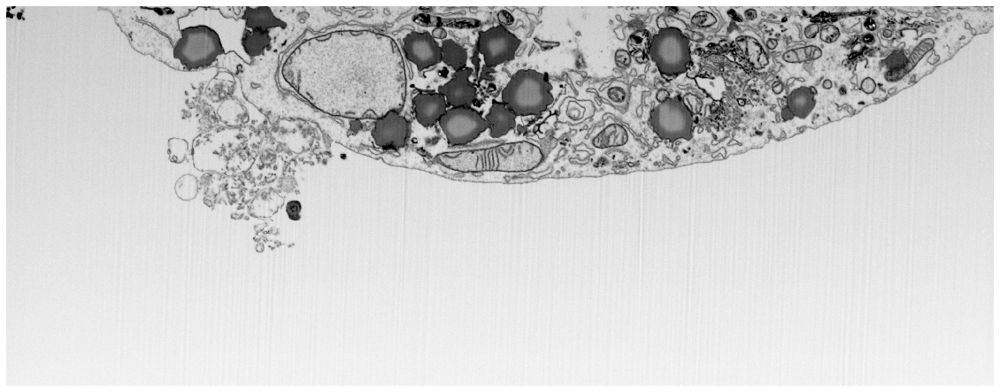

In [10]:
img = imread(rawimglist[rawfdlist[0]][500])
plt.figure(figsize = (20,20))
plt.imshow(img, cmap='gray')
plt.axis('off')
plt.show()

In [11]:
model = load_model(path_model)
print(model)

In [12]:
'''
from tensorflow.keras import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, concatenate, Conv2D, Conv2DTranspose, Dropout, Flatten, Dense, Activation, Layer, Reshape, Permute, Lambda
from tensorflow.keras.layers import Conv3D, MaxPool3D, ZeroPadding3D
from tensorflow.keras.layers import Conv2D, MaxPool2D, UpSampling2D, ZeroPadding2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.optimizers import Adam, Adadelta
from tensorflow.keras import backend as K

inputs = Input((None, None, 1))
conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(inputs)
print ("conv1 shape:",conv1.shape)
conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv1)
print ("conv1 shape:",conv1.shape)

pool1 = MaxPool2D(pool_size=(2, 2))(conv1)
print ("pool1 shape:",pool1.shape)

conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool1)
print ("conv2 shape:",conv2.shape)
conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv2)
print ("conv2 shape:",conv2.shape)
pool2 = MaxPool2D(pool_size=(2, 2))(conv2)
print ("pool2 shape:",pool2.shape)

conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool2)
print ("conv3 shape:",conv3.shape)
conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv3)
print ("conv3 shape:",conv3.shape)
pool3 = MaxPool2D(pool_size=(2, 2))(conv3)
print ("pool3 shape:",pool3.shape)

conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool3)
conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv4)
drop4 = Dropout(0.5)(conv4)
pool4 = MaxPool2D(pool_size=(2, 2))(drop4)

conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool4)
conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv5)
drop5 = Dropout(0.5)(conv5)

up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop5))
merge6 = concatenate([drop4,up6])

conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge6)
conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv6)

up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(conv6))
merge7 = concatenate([conv3, up7])

conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge7)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv7)

up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(conv7))
merge8 = concatenate([conv2, up8])

conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge8)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv8)

up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(conv8))
merge9 = concatenate([conv1, up9])

conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)

output = Conv2D(1, 1, activation = 'sigmoid')(conv9)

output_shape = Model(inputs , conv9).output_shape

newmodel = Model(inputs, output)

newmodel.compile(loss="binary_crossentropy", lr=1e-5, metrics=['accuracy'])
newmodel.summary()
'''

'\nfrom tensorflow.keras import Sequential\nfrom tensorflow.keras.models import Model\nfrom tensorflow.keras.layers import Input, concatenate, Conv2D, Conv2DTranspose, Dropout, Flatten, Dense, Activation, Layer, Reshape, Permute, Lambda\nfrom tensorflow.keras.layers import Conv3D, MaxPool3D, ZeroPadding3D\nfrom tensorflow.keras.layers import Conv2D, MaxPool2D, UpSampling2D, ZeroPadding2D\nfrom tensorflow.keras.layers import BatchNormalization\nfrom tensorflow.keras.optimizers import Adam, Adadelta\nfrom tensorflow.keras import backend as K\n\ninputs = Input((None, None, 1))\nconv1 = Conv2D(64, 3, activation = \'relu\', padding = \'same\', kernel_initializer = \'he_normal\')(inputs)\nprint ("conv1 shape:",conv1.shape)\nconv1 = Conv2D(64, 3, activation = \'relu\', padding = \'same\', kernel_initializer = \'he_normal\')(conv1)\nprint ("conv1 shape:",conv1.shape)\n\npool1 = MaxPool2D(pool_size=(2, 2))(conv1)\nprint ("pool1 shape:",pool1.shape)\n\nconv2 = Conv2D(128, 3, activation = \'relu\

In [13]:
'''
newmodel.load_weights(path_model)
'''

'\nnewmodel.load_weights(path_model)\n'

In [14]:
'''
# folder name
fdnm_small = 'batch_01'
dir_checker(fdnm_small, os.path.join(pred_path, 'pred_img'))
img_path_small = os.path.join(pred_path, 'pred_img', fdnm_small)

# create folder list
for folder in rawfdlist:
    dir_checker(folder, img_path_small)
'''

"\n# folder name\nfdnm_small = 'batch_01'\ndir_checker(fdnm_small, os.path.join(pred_path, 'pred_img'))\nimg_path_small = os.path.join(pred_path, 'pred_img', fdnm_small)\n\n# create folder list\nfor folder in rawfdlist:\n    dir_checker(folder, img_path_small)\n"

In [15]:
'''
from core.imageprep import create_crop_idx, crop_to_patch
from core.train_predict import stack_predict_v2

for idx in trange(len(rawfdlist)):
    
    folder = rawfdlist[idx]
    
    pred_input_imgs =  rawimglist_small[folder]
    pred_output_path = os.path.join(pred_path, 'pred_img', fdnm_small, folder)
    
    img = imread(rawimglist_small[folder][0])
    # cropidx = create_crop_idx(img.shape, (IMG_HEIGHT, IMG_WIDTH), overlap_fac = 0.1)
    # print(cropidx)
    
    stack_predict_v2(
                input_imgpath = pred_input_imgs, 
                output_imgpath = pred_output_path, 
                # cropidx = cropidx, 
                model = newmodel, 
                rescale = 1./255.,
                # patch_size = (IMG_HEIGHT, IMG_WIDTH), 
                predict_threshold = 0.5)
'''

"\nfrom core.imageprep import create_crop_idx, crop_to_patch\nfrom core.train_predict import stack_predict_v2\n\nfor idx in trange(len(rawfdlist)):\n    \n    folder = rawfdlist[idx]\n    \n    pred_input_imgs =  rawimglist_small[folder]\n    pred_output_path = os.path.join(pred_path, 'pred_img', fdnm_small, folder)\n    \n    img = imread(rawimglist_small[folder][0])\n    # cropidx = create_crop_idx(img.shape, (IMG_HEIGHT, IMG_WIDTH), overlap_fac = 0.1)\n    # print(cropidx)\n    \n    stack_predict_v2(\n                input_imgpath = pred_input_imgs, \n                output_imgpath = pred_output_path, \n                # cropidx = cropidx, \n                model = newmodel, \n                rescale = 1./255.,\n                # patch_size = (IMG_HEIGHT, IMG_WIDTH), \n                predict_threshold = 0.5)\n"

## Prediction Small Dataset with tiles
### Create Folder 

In [16]:
'''
# folder name
fdnm_small = 'batch_01'
dir_checker(fdnm_small, os.path.join(pred_path, 'pred_img'))
img_path_small = os.path.join(pred_path, 'pred_img', fdnm_small)

# create folder list
for folder in rawfdlist:
    dir_checker(folder, img_path_small)
'''

"\n# folder name\nfdnm_small = 'batch_01'\ndir_checker(fdnm_small, os.path.join(pred_path, 'pred_img'))\nimg_path_small = os.path.join(pred_path, 'pred_img', fdnm_small)\n\n# create folder list\nfor folder in rawfdlist:\n    dir_checker(folder, img_path_small)\n"

### Tiling Prediction with Stack Input
- Crop image into patched by a given overlap factor
- Export a cropping index
- Construct patches back into a image 

In [17]:
'''
from core.imageprep import create_crop_idx, crop_to_patch

for idx in trange(len(rawfdlist)):
    
    folder = rawfdlist[idx]
    
    pred_input_imgs =  rawimglist_small[folder]
    pred_output_path = os.path.join(pred_path, 'pred_img', fdnm_small, folder)
    
    img = imread(rawimglist_small[folder][0])
    cropidx = create_crop_idx(img.shape, (IMG_HEIGHT, IMG_WIDTH), overlap_fac = 0.1)
    # print(cropidx)
    
    stack_predict(
                input_imgpath = pred_input_imgs, 
                output_imgpath = pred_output_path, 
                cropidx = cropidx, 
                model = model, 
                rescale = 1./255.,
                patch_size = (IMG_HEIGHT, IMG_WIDTH), 
                predict_threshold = 0.5)
'''

"\nfrom core.imageprep import create_crop_idx, crop_to_patch\n\nfor idx in trange(len(rawfdlist)):\n    \n    folder = rawfdlist[idx]\n    \n    pred_input_imgs =  rawimglist_small[folder]\n    pred_output_path = os.path.join(pred_path, 'pred_img', fdnm_small, folder)\n    \n    img = imread(rawimglist_small[folder][0])\n    cropidx = create_crop_idx(img.shape, (IMG_HEIGHT, IMG_WIDTH), overlap_fac = 0.1)\n    # print(cropidx)\n    \n    stack_predict(\n                input_imgpath = pred_input_imgs, \n                output_imgpath = pred_output_path, \n                cropidx = cropidx, \n                model = model, \n                rescale = 1./255.,\n                patch_size = (IMG_HEIGHT, IMG_WIDTH), \n                predict_threshold = 0.5)\n"

## Prediction Small Dataset with tiles (whole stack)
### Create Folder 

In [18]:

# folder name
fdnm_whole = 'batch_02'
dir_checker(fdnm_whole, os.path.join(pred_path, 'pred_img'))
img_path_whole = os.path.join(pred_path, 'pred_img', fdnm_whole)

# create folder list
for folder in rawfdlist:
    dir_checker(folder, img_path_whole)


batch_02 exists in D:PerlmutterData\dl_seg_project_raw\pred_img
data_d00_batch01_loc01 exists in D:PerlmutterData\dl_seg_project_raw\pred_img\batch_02
data_d07_batch01_loc01 exists in D:PerlmutterData\dl_seg_project_raw\pred_img\batch_02
data_d14_batch01_loc01 exists in D:PerlmutterData\dl_seg_project_raw\pred_img\batch_02
data_d17_batch01_loc01 exists in D:PerlmutterData\dl_seg_project_raw\pred_img\batch_02
data_d21_batch01_loc01 exists in D:PerlmutterData\dl_seg_project_raw\pred_img\batch_02


### Tiling Prediction with Stack Input
- Crop image into patched by a given overlap factor
- Export a cropping index
- Construct patches back into a image 

In [19]:

from core.imageprep import create_crop_idx, crop_to_patch

for idx in trange(len(rawfdlist)):
    
    folder = rawfdlist[idx]
    
    pred_input_imgs =  rawimglist[folder]
    pred_output_path = os.path.join(pred_path, 'pred_img', fdnm_whole, folder)
    
    img = imread(rawimglist_small[folder][0])
    cropidx = create_crop_idx(img.shape, (IMG_HEIGHT, IMG_WIDTH), overlap_fac = 0.1)
    # print(cropidx)
    
    stack_predict(
                input_imgpath = pred_input_imgs, 
                output_imgpath = pred_output_path, 
                cropidx = cropidx, 
                model = model, 
                rescale = 1./255.,
                patch_size = (IMG_HEIGHT, IMG_WIDTH), 
                predict_threshold = 0.5)



Image Shape: 883, 2297
Patch size: 256, 256
Overlap Factor: 0.1
Step y: 230
Step y count: 4
Remainder in y: 167
Step x: 230
Step x count: 10
Remainder in x: 201



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 883, 2297




Image Shape: 844, 2238
Patch size: 256, 256
Overlap Factor: 0.1
Step y: 230
Step y count: 4
Remainder in y: 128
Step x: 230
Step x count: 10
Remainder in x: 142



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 844, 2238




Image Shape: 938, 2216
Patch size: 256, 256
Overlap Factor: 0.1
Step y: 230
Step y count: 4
Remainder in y: 222
Step x: 230
Step x count: 10
Remainder in x: 120



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 938, 2216




Image Shape: 930, 2219
Patch size: 256, 256
Overlap Factor: 0.1
Step y: 230
Step y count: 4
Remainder in y: 214
Step x: 230
Step x count: 10
Remainder in x: 123



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 930, 2219




Image Shape: 793, 2285
Patch size: 256, 256
Overlap Factor: 0.1
Step y: 230
Step y count: 4
Remainder in y: 77
Step x: 230
Step x count: 10
Remainder in x: 189



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285



40/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================


Patch Image Shape: 256, 256
Target Image Size: 793, 2285


